In [ ]:
DATASET DESCRIPTION (Appliances Energy Prediction data)

The data set is at 10 min for about 4.5 months. 
The house temperature and humidity conditions were monitored with a ZigBee wireless sensor network. 
Each wireless node transmitted the temperature and humidity conditions around 3.3 min. 
Then, the wireless data was averaged for 10 minutes periods. 
The energy data was logged every 10 minutes with m-bus energy meters. 
Weather from the nearest airport weather station (Chievres Airport, Belgium) was downloaded from a public data set
from Reliable Prognosis (rp5.ru), and merged together with the experimental data sets using the date and time column.
Two random variables have been included in the data set for testing the regression models and to filter out non predictive
attributes (parameters). The attribute information can be seen below.

Attribute Information:

Date, time year-month-day hour:minute:second

Appliances, energy use in Wh

lights, energy use of light fixtures in the house in Wh

T1, Temperature in kitchen area, in Celsius

RH_1, Humidity in kitchen area, in %

T2, Temperature in living room area, in Celsius

RH_2, Humidity in living room area, in %

T3, Temperature in laundry room area

RH_3, Humidity in laundry room area, in %

T4, Temperature in office room, in Celsius

RH_4, Humidity in office room, in %

T5, Temperature in bathroom, in Celsius

RH_5, Humidity in bathroom, in %

T6, Temperature outside the building (north side), in Celsius

RH_6, Humidity outside the building (north side), in %

T7, Temperature in ironing room , in Celsius

RH_7, Humidity in ironing room, in %

T8, Temperature in teenager room 2, in Celsius

RH_8, Humidity in teenager room 2, in %

T9, Temperature in parents room, in Celsius

RH_9, Humidity in parents room, in %

To, Temperature outside (from Chievres weather station), in Celsius

Pressure (from Chievres weather station), in mm Hg

RH_out, Humidity outside (from Chievres weather station), in %

Wind speed (from Chievres weather station), in m/s

Visibility (from Chievres weather station), in km

Tdewpoint (from Chievres weather station), Â °C

rv1, Random variable 1, nondimensional

rv2, Random variable 2, nondimensional

To answer some questions, you will need to normalize the dataset using the MinMaxScaler after removing the
following columns: [“date”, “lights”]. The target variable is “Appliances”. Use a 70-30 train-test set split with a 
random state of 42 (for reproducibility). Run a multiple linear regression using the training set and evaluate your 
model on the test set.


In [10]:
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns
import os


'C:\\Users\\DIANNE ATTAH'

In [13]:
power = pd.read_csv('energydata_complete.csv')

In [14]:
power.head()

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,1/11/2016 17:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,...,17.033333,45.53,6.60,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433
1,1/11/2016 17:10,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,...,17.066667,45.56,6.48,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195
2,1/11/2016 17:20,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,...,17.000000,45.50,6.37,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668
3,1/11/2016 17:30,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,...,17.000000,45.40,6.25,733.8,92.0,6.000000,51.500000,5.0,45.410390,45.410390
4,1/11/2016 17:40,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,...,17.000000,45.40,6.13,733.9,92.0,5.666667,47.666667,4.9,10.084097,10.084097


In [15]:
power.tail()

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
19730,5/27/2016 17:20,100,0,25.566667,46.560000,25.890000,42.025714,27.200000,41.163333,24.7,...,23.2,46.7900,22.7,755.2,55.666667,3.333333,23.666667,13.3,43.096812,43.096812
19731,5/27/2016 17:30,90,0,25.500000,46.500000,25.754000,42.080000,27.133333,41.223333,24.7,...,23.2,46.7900,22.6,755.2,56.000000,3.500000,24.500000,13.3,49.282940,49.282940
19732,5/27/2016 17:40,270,10,25.500000,46.596667,25.628571,42.768571,27.050000,41.690000,24.7,...,23.2,46.7900,22.5,755.2,56.333333,3.666667,25.333333,13.3,29.199117,29.199117
19733,5/27/2016 17:50,420,10,25.500000,46.990000,25.414000,43.036000,26.890000,41.290000,24.7,...,23.2,46.8175,22.3,755.2,56.666667,3.833333,26.166667,13.2,6.322784,6.322784
19734,5/27/2016 18:00,430,10,25.500000,46.600000,25.264286,42.971429,26.823333,41.156667,24.7,...,23.2,46.8450,22.2,755.2,57.000000,4.000000,27.000000,13.2,34.118851,34.118851


In [9]:
power.shape

(19735, 29)

In [10]:
power.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19735 entries, 0 to 19734
Data columns (total 29 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   date         19735 non-null  object 
 1   Appliances   19735 non-null  int64  
 2   lights       19735 non-null  int64  
 3   T1           19735 non-null  float64
 4   RH_1         19735 non-null  float64
 5   T2           19735 non-null  float64
 6   RH_2         19735 non-null  float64
 7   T3           19735 non-null  float64
 8   RH_3         19735 non-null  float64
 9   T4           19735 non-null  float64
 10  RH_4         19735 non-null  float64
 11  T5           19735 non-null  float64
 12  RH_5         19735 non-null  float64
 13  T6           19735 non-null  float64
 14  RH_6         19735 non-null  float64
 15  T7           19735 non-null  float64
 16  RH_7         19735 non-null  float64
 17  T8           19735 non-null  float64
 18  RH_8         19735 non-null  float64
 19  T9  

In [16]:
#Removing unwanted variables
drop_cols = ['date', 'lights']
power = power.drop(drop_cols, axis = 1)

In [17]:
power.columns

Index(['Appliances', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'T4', 'RH_4',
       'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8', 'RH_8', 'T9', 'RH_9',
       'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed', 'Visibility',
       'Tdewpoint', 'rv1', 'rv2'],
      dtype='object')

In [18]:
power.describe()

,Appliances,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
count,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,...,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000
mean,97.694958,21.686571,40.259739,20.341219,40.420420,22.267611,39.242500,20.855335,39.026904,19.592106,...,19.485828,41.552401,7.412580,755.522602,79.750418,4.039752,38.330834,3.760995,24.988033,24.988033
std,102.524891,1.606066,3.979299,2.192974,4.069813,2.006111,3.254576,2.042884,4.341321,1.844623,...,2.014712,4.151497,5.318464,7.399441,14.901088,2.451221,11.794719,4.195248,14.496634,14.496634
min,10.000000,16.790000,27.023333,16.100000,20.463333,17.200000,28.766667,15.100000,27.660000,15.330000,...,14.890000,29.166667,-5.000000,729.300000,24.000000,0.000000,1.000000,-6.600000,0.005322,0.005322
25%,50.000000,20.760000,37.333333,18.790000,37.900000,20.790000,36.900000,19.530000,35.530000,18.277500,...,18.000000,38.500000,3.670000,750.933333,70.333333,2.000000,29.000000,0.900000,12.497889,12.497889
50%,60.000000,21.600000,39.656667,20.000000,40.500000,22.100000,38.530000,20.666667,38.400000,19.390000,...,19.390000,40.900000,6.920000,756.100000,83.666667,3.666667,40.000000,3.430000,24.897653,24.897653
75%,100.000000,22.600000,43.066667,21.500000,43.260000,23.290000,41.760000,22.100000,42.156667,20.619643,...,20.600000,44.338095,10.400000,760.933333,91.666667,5.500000,40.000000,6.570000,37.583769,37.583769
max,1080.000000,26.260000,63.360000,29.856667,56.026667,29.236000,50.163333,26.200000,51.090000,25.795000,...,24.500000,53.326667,26.100000,772.300000,100.000000,14.000000,66.000000,15.500000,49.996530,49.996530


In [9]:
power.notna()

,Appliances,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
1,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
2,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
3,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
4,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19730,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
19731,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
19732,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
19733,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True


In [10]:
power.isnull().sum()

Appliances     0
T1             0
RH_1           0
T2             0
RH_2           0
T3             0
RH_3           0
T4             0
RH_4           0
T5             0
RH_5           0
T6             0
RH_6           0
T7             0
RH_7           0
T8             0
RH_8           0
T9             0
RH_9           0
T_out          0
Press_mm_hg    0
RH_out         0
Windspeed      0
Visibility     0
Tdewpoint      0
rv1            0
rv2            0
dtype: int64

In [11]:
power.nunique()

Appliances        92
T1               722
RH_1            2547
T2              1650
RH_2            3376
T3              1426
RH_3            2618
T4              1390
RH_4            2987
T5              2263
RH_5            7571
T6              4446
RH_6            9708
T7              1955
RH_7            5891
T8              2228
RH_8            6649
T9               924
RH_9            3388
T_out           1055
Press_mm_hg     2189
RH_out           566
Windspeed        189
Visibility       412
Tdewpoint       1118
rv1            19735
rv2            19735
dtype: int64

In [110]:
from sklearn.datasets import make_regression
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_validate



In [13]:
type(power)

pandas.core.frame.DataFrame

In [14]:
power.keys()

Index(['Appliances', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'T4', 'RH_4',
       'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8', 'RH_8', 'T9', 'RH_9',
       'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed', 'Visibility',
       'Tdewpoint', 'rv1', 'rv2'],
      dtype='object')

In [81]:
!pip install --user scikit-learn

In [82]:
import sys

In [83]:
sys.path.append

<function list.append(object, /)>

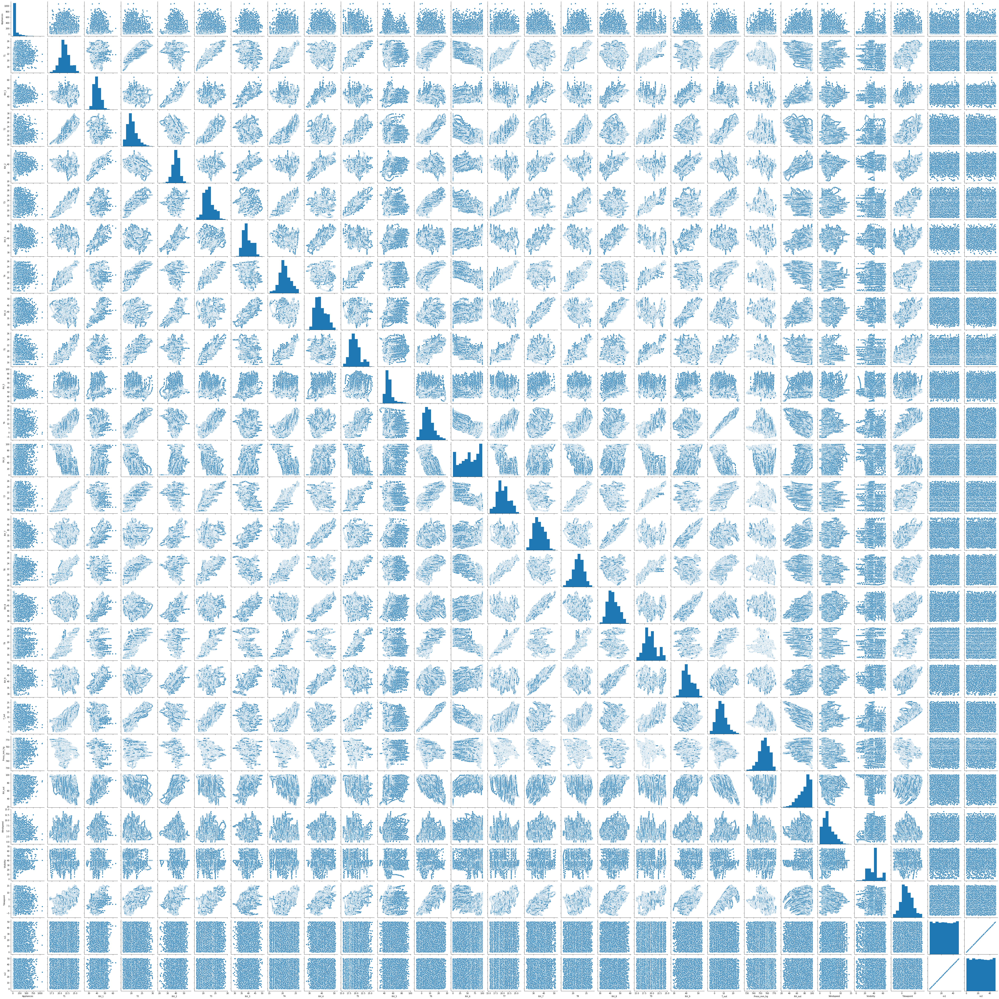

In [15]:
#DATA VIZUALIZATION
#Using scatter to determine if the dataset contains Outliers
sns.pairplot(power)

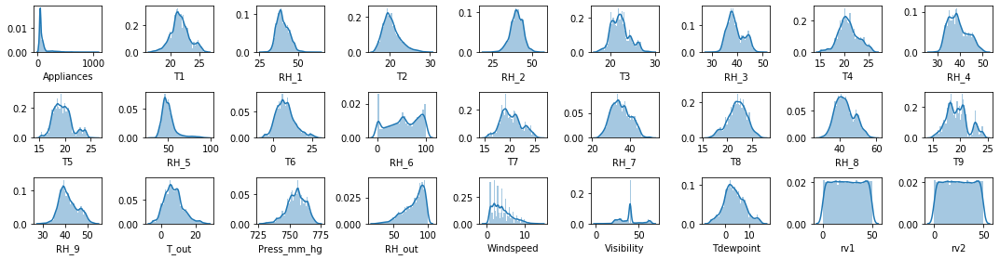

In [45]:

rows = 3
cols = 9
fig, ax = plt.subplots(nrows =rows, ncols =cols,figsize =(15,4))


 #For feature selection to predict final target
col = power.columns
index = 0
for a in range (rows):
        for b in range (cols):
            sns.distplot(power[col[index]],  ax= ax[a][b])
            index = index + 1

plt.tight_layout()

In [130]:
#For correlation
#To select a feature with the aid of correlation
corrr = power.corr()
corrr

,Appliances,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
Appliances,1.000000,0.055447,0.086031,0.120073,-0.060465,0.085060,0.036292,0.040281,0.016965,0.019760,...,0.010010,-0.051462,0.099155,-0.034885,-0.152282,0.087122,0.000230,0.015357,-0.011145,-0.011145
T1,0.055447,1.000000,0.164006,0.836834,-0.002509,0.892402,-0.028550,0.877001,0.097861,0.885247,...,0.844777,0.071756,0.682854,-0.150574,-0.345481,-0.087654,-0.076210,0.571333,-0.006203,-0.006203
RH_1,0.086031,0.164006,1.000000,0.269839,0.797535,0.253230,0.844677,0.106180,0.880359,0.205797,...,0.115263,0.764001,0.340788,-0.293957,0.274126,0.204932,-0.021057,0.639125,-0.000699,-0.000699
T2,0.120073,0.836834,0.269839,1.000000,-0.165610,0.735245,0.121497,0.762066,0.231563,0.720550,...,0.675535,0.157346,0.792247,-0.133028,-0.505291,0.052495,-0.069721,0.582632,-0.011087,-0.011087
RH_2,-0.060465,-0.002509,0.797535,-0.165610,1.000000,0.137319,0.678326,-0.047304,0.721435,0.110409,...,0.054544,0.676467,0.033703,-0.255646,0.584911,0.069190,-0.005368,0.499154,0.006275,0.006275
T3,0.085060,0.892402,0.253230,0.735245,0.137319,1.000000,-0.011234,0.852778,0.122737,0.888169,...,0.901324,0.134602,0.699420,-0.189974,-0.281718,-0.100776,-0.102310,0.645909,-0.005194,-0.005194
RH_3,0.036292,-0.028550,0.844677,0.121497,0.678326,-0.011234,1.000000,-0.140457,0.898978,-0.050062,...,-0.195270,0.833538,0.118237,-0.233274,0.356192,0.263188,0.017041,0.414398,-0.000477,-0.000477
T4,0.040281,0.877001,0.106180,0.762066,-0.047304,0.852778,-0.140457,1.000000,-0.048650,0.871813,...,0.889439,-0.025549,0.663479,-0.075292,-0.388602,-0.185747,-0.104768,0.519504,-0.001815,-0.001815
RH_4,0.016965,0.097861,0.880359,0.231563,0.721435,0.122737,0.898978,-0.048650,1.000000,0.091812,...,-0.044518,0.856591,0.293307,-0.250748,0.336813,0.300192,0.002636,0.616508,-0.001787,-0.001787
T5,0.019760,0.885247,0.205797,0.720550,0.110409,0.888169,-0.050062,0.871813,0.091812,1.000000,...,0.911055,0.072308,0.651335,-0.170999,-0.273953,-0.145011,-0.084164,0.588393,-0.005490,-0.005490


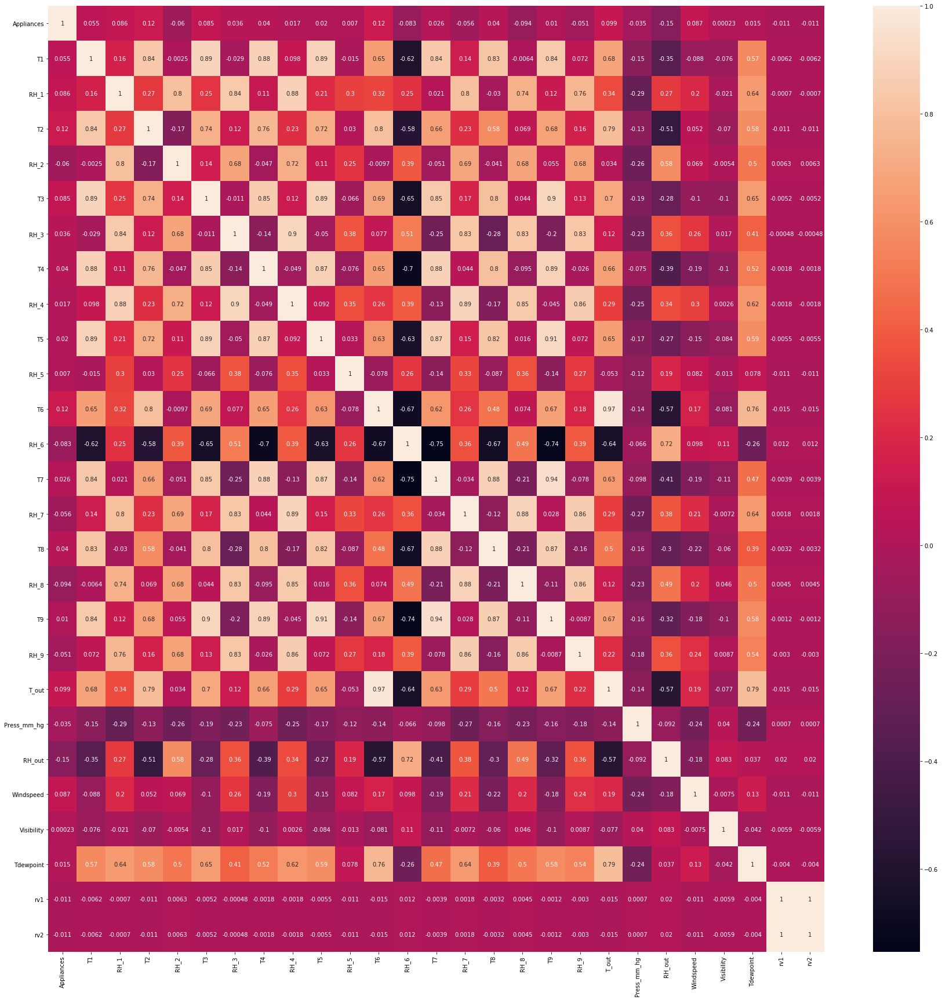

In [131]:
#plot heat map
fig, ax = plt.subplots(figsize =(30,30))
sns.heatmap(corrr, xticklabels=corrr.columns, yticklabels=corrr.columns, annot=True)

In [132]:
corrr.index.values

array(['Appliances', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'T4',
       'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8', 'RH_8',
       'T9', 'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed',
       'Visibility', 'Tdewpoint', 'rv1', 'rv2'], dtype=object)

In [133]:
def get_redundant_pairs(power):
    pairs_to_drop = set()
    cols = power.columns
    for w in range(0, power.shape[1]):
        for e in range(0, w+1):
            pairs_to_drop.add((cols[w], cols[e]))
    return pairs_to_drop

 

def get_top_abs_correlations(power, n=5):
    one_corr = power.corr().abs().unstack()
    labels_to_drop = get_redundant_pairs(power)
    au_corr = one_corr.drop(labels=labels_to_drop).sort_values(ascending=False)
    return one_corr[0:n]


In [134]:
("Top Absolute Correlations")
(get_top_abs_correlations(power, 42))

Appliances  Appliances     1.000000
            T1             0.055447
            RH_1           0.086031
            T2             0.120073
            RH_2           0.060465
            T3             0.085060
            RH_3           0.036292
            T4             0.040281
            RH_4           0.016965
            T5             0.019760
            RH_5           0.006955
            T6             0.117638
            RH_6           0.083178
            T7             0.025801
            RH_7           0.055642
            T8             0.039572
            RH_8           0.094039
            T9             0.010010
            RH_9           0.051462
            T_out          0.099155
            Press_mm_hg    0.034885
            RH_out         0.152282
            Windspeed      0.087122
            Visibility     0.000230
            Tdewpoint      0.015357
            rv1            0.011145
            rv2            0.011145
T1          Appliances     0

In [135]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()

normalized_features = pd.DataFrame(scaler.fit_transform(power), columns=power.columns)

In [136]:
features = normalized_features.drop(['Appliances'], axis=1)

target = normalized_features['Appliances']

In [137]:
x_train.shape, x_test.shape

((13814, 26), (5921, 26))

In [138]:
linear_model = LinearRegression() #fit the model to the training dataset
linear_model.fit(x_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [153]:
y_predict_values = linear_model.predict(x_test)

In [154]:
y_predict_values,y_test

(array([0.03319482, 0.24412217, 0.0340092 , ..., 0.06843864, 0.09999407,
        0.05760656]),
 8980     0.028037
 2754     0.074766
 9132     0.037383
 14359    0.037383
 8875     0.056075
            ...   
 831      0.224299
 10993    0.046729
 11761    0.037383
 12364    0.093458
 11863    0.037383
 Name: Appliances, Length: 5921, dtype: float64)

In [155]:
df = pd.DataFrame(data = [y_predict_values, y_test])
df.T

,0,1
0,0.033195,0.028037
1,0.244122,0.074766
2,0.034009,0.037383
3,0.105398,0.037383
4,0.023362,0.056075
...,...,...
5916,0.086593,0.224299
5917,0.075139,0.046729
5918,0.068439,0.037383
5919,0.099994,0.093458


In [172]:
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error,mean_squared_error

In [174]:
score = r2_score(y_test,y_predict_values)
mae = mean_absolute_error(y_test,y_predict_values)
mse = mean_squared_error(y_test,y_predict_values)


In [176]:
print('r2_scores:',score)
print('mae:',mae)
print('mse:',mse)

r2_scores: 0.1488868301298124
mae: 0.05013254981181856
mse: 0.0076589195445784675


In [177]:
total_features = []
total_features_name = []
selected_correlation_value = []
r2_scores = []
mae_value = []
mse_value = []

In [215]:
def performance_metrics(features,th,  y_true, y_predict_values):
    score = r2_score(y_true,y_predict_values)
    mae = mean_absolute_error(y_true,y_predict_values)
    mse = mean_squared_error(y_true,y_predict_values)

    total_features.append(len(features)-1)
    total_features_name.append(str(features))
    selected_correlation_value.append(th)
    r2_scores.append(score)
    mae_value.append(mae)
    mse_value.append(mse)
    metrics_Dataframe = pd.DataFrame(data = [total_features_name,total_features, selected_correlation_value,r2_scores,mae_value,mse_value] )
    return metrics_Dataframe.T

In [216]:
performance_metrics(power.columns.values, threshold,y_test,y_predict_values)

,0,1,2,3,4,5
0,['Appliances' 'T1' 'RH_1' 'T2' 'RH_2' 'T3' 'RH...,26,0.7,0.148887,0.0501325,0.00765892
1,['Appliances' 'T1' 'RH_1' 'T2' 'RH_2' 'T3' 'RH...,26,0.7,0.148887,0.0501325,0.00765892
2,['Appliances' 'T1' 'RH_1' 'T2' 'RH_2' 'T3' 'RH...,26,0.7,0.148887,0.0501325,0.00765892
3,['Appliances' 'T1' 'RH_1' 'T2' 'RH_2' 'T3' 'RH...,26,0.7,0.148887,0.0501325,0.00765892
4,['Appliances' 'T1' 'RH_1' 'T2' 'RH_2' 'T3' 'RH...,26,0.7,0.148887,0.0501325,0.00765892
5,['Appliances' 'T1' 'RH_1' 'T2' 'RH_2' 'T3' 'RH...,26,0.7,0.148887,0.0501325,0.00765892


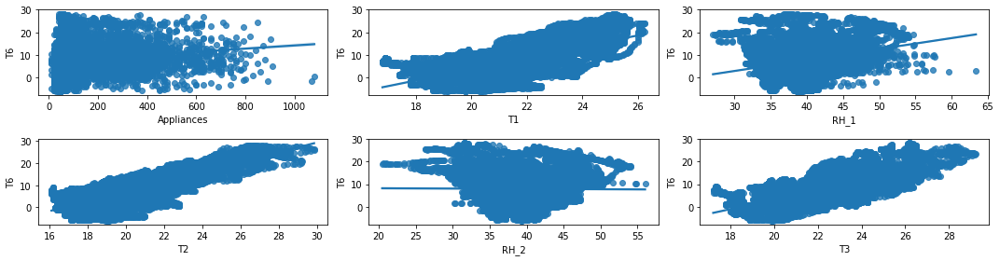

In [183]:
rows = 2
cols = 3
fig, ax = plt.subplots(nrows =rows, ncols =cols,figsize =(15,4))


 #For feature selection to predict final target
col = power.columns
index = 0
for a in range (rows):
        for b in range (cols):
            sns.regplot(x = power[col[index]], y = power['T6'] ,ax= ax[a][b])
            index = index + 1

plt.tight_layout()

In [184]:
from sklearn.model_selection import train_test_split

In [198]:
def get_y_predict_values(power):
    x = power.drop(labels = ['rv1'], axis = 1)
    y = power['rv1']

    x_train, x_test, y_train, y_test = train_test_split(features, target, test_size = 0.3, random_state = 42)
    model = LinearRegression()
    model.fit(x_train,y_train)
    y_predict_values = model.predict(x_test)
    return y_predict_values

In [199]:
y_predict_values = get_y_predict_values(power)

In [ ]:
performance_metrics(power.columns.values,threshold,y_test,y_predict_values)

In [194]:
corrr['rv2']

Appliances    -0.011145
T1            -0.006203
RH_1          -0.000699
T2            -0.011087
RH_2           0.006275
T3            -0.005194
RH_3          -0.000477
T4            -0.001815
RH_4          -0.001787
T5            -0.005490
RH_5          -0.011056
T6            -0.015086
RH_6           0.011671
T7            -0.003900
RH_7           0.001820
T8            -0.003210
RH_8           0.004480
T9            -0.001227
RH_9          -0.002955
T_out         -0.015259
Press_mm_hg    0.000699
RH_out         0.020441
Windspeed     -0.011342
Visibility    -0.005889
Tdewpoint     -0.003950
rv1            1.000000
rv2            1.000000
Name: rv2, dtype: float64

In [ ]:
threshold = 0.70
value = get_redundant_pairs['rv1',threshold]
value

In [120]:
from sklearn.linear_model import Ridge, Lasso, LinearRegression, ElasticNet
from sklearn.ensemble import RandomForestRegressor, ExtraTreesRegressor, GradientBoostingRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor

# import the evaluation metrics
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# create a dictionary of different algorithms 
models = {'Ridge': Ridge(),
        'Lasso': Lasso(),
        'ElasticNet':ElasticNet(),
        'LinearRegression':LinearRegression(),
        'KNeighborsRegressor':KNeighborsRegressor(),
        'RandomForestRegressor':RandomForestRegressor(),
        'ExtraTreesRegressor':ExtraTreesRegressor(),
        'GradientBoostingRegressor':GradientBoostingRegressor(),
        'DecisionTreeRegressor':DecisionTreeRegressor()}

In [185]:
def pipeline(models, x_train, x_test, y_train, y_test):
   
    prop = []
    
    # loop through the models
    for reg_name, regressor in models.items():
        
        reg_dict = {} # empty dict for storing properties of each models
        # store the name of each model
        reg_dict['Name'] = reg_name
        # fit the regressor model
        regressor.fit(x_train, y_train)
        # compute the Train_score
        reg_dict['Train_score'] = regressor.score(x_train, y_train)
        # compute the test scores
        reg_dict['Test_score'] = regressor.score(x_test, y_test)
        # compute the mean_absolute_error
        reg_dict['MAE'] = mean_absolute_error(y_test, regressor.predict(x_test))
        #compute the mean_squared_error
        reg_dict['MSE'] = mean_squared_error(y_test, regressor.predict(x_test))
        # compute the RMSE
        reg_dict['RMSE'] = np.sqrt(mean_squared_error(y_test, regressor.predict(x_test)))
        # append the properties of a single regressor to the prop list
        prop.append(reg_dict)
     
    # create a dataframe with a list of all the model properties
    view_power = pd.DataFrame(prop)
    
    # plot a bar chart to visualize the performance of each model
    view_power.plot(x='Name', y=['Train_score', 'Test_score', 'MAE', 'MSE', 'RMSE'], kind='bar', figsize=(20,10),
               title='Performance scores of different models')
        
        
    return view_power

,Name,Train_score,Test_score,MAE,MSE,RMSE
0,Ridge,0.143771,0.147523,0.050068,0.007671,0.087585
1,Lasso,0.000000,-0.000001,0.056523,0.008999,0.094862
2,ElasticNet,0.000000,-0.000001,0.056523,0.008999,0.094862
3,LinearRegression,0.144725,0.148887,0.050133,0.007659,0.087515
4,KNeighborsRegressor,0.545086,0.271775,0.040246,0.006553,0.080951
5,RandomForestRegressor,0.936982,0.564570,0.029937,0.003918,0.062596
6,ExtraTreesRegressor,1.000000,0.620508,0.027268,0.003415,0.058437
7,GradientBoostingRegressor,0.336853,0.245899,0.045238,0.006786,0.082377
8,DecisionTreeRegressor,1.000000,0.187957,0.036611,0.007307,0.085483


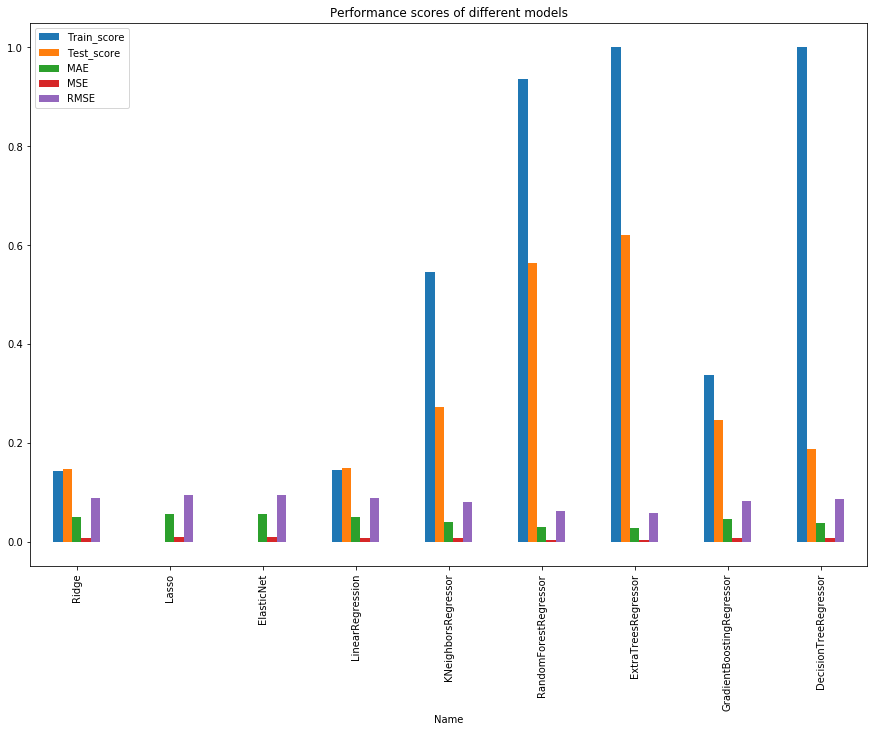

In [125]:
pipeline(models, x_train, x_test, y_train, y_test)

In [126]:
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

# define the param grid
param_grid = [{
              'max_depth': [80, 150, 200,250],
              'n_estimators' : [10, 50, 100, 200, 250],
              'max_features': ["auto", "sqrt", "log2"]
            }]

reg = ExtraTreesRegressor(random_state=42)

# Instantiate the grid search model
grid_search = RandomizedSearchCV(reg, param_grid, cv = 6, n_jobs = -1 , scoring='r2' , verbose=2)

# fit the gridserch model
grid_search.fit(x_train, y_train)

Fitting 6 folds for each of 10 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:  4.1min
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:  5.3min finished


RandomizedSearchCV(cv=6, error_score=nan,
                   estimator=ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0,
                                                 criterion='mse',
                                                 max_depth=None,
                                                 max_features='auto',
                                                 max_leaf_nodes=None,
                                                 max_samples=None,
                                                 min_impurity_decrease=0.0,
                                                 min_impurity_split=None,
                                                 min_samples_leaf=1,
                                                 min_samples_split=2,
                                                 min_weight_fraction_leaf=0.0,
                                                 n_estimators=100, n_jobs=None,
                                                 oob_score=False,
                         

In [127]:
(f'best param of the ExtraTreeRegressor is: {grid_search.best_params_}')

"best param of the ExtraTreeRegressor is: {'n_estimators': 200, 'max_features': 'sqrt', 'max_depth': 250}"

In [195]:

best_model = grid_search.best_estimator_

(f'print R2_score on training_set with tuned parameters: {best_model.score(x_train, y_train)}')
(f'print R2_score on testing_set with tuned parameters: {round(best_model.score(x_test, y_test), 3)}')
(f'print MSE_score on testing_set with tuned parameters: {round(mean_squared_error(y_test, best_model.predict(x_test)), 3)}')
(f'print RMSE_score on testing_set with tuned parameters: {round(np.sqrt(mean_squared_error(y_test, best_model.predict(x_test))), 3)}')

'print RMSE_score on testing_set with tuned parameters: 0.058'

In [ ]:
param_grid = [
 {'n_estimators': [3, 10, 30, 50], 'max_features': [2, 4, 6, 8, 10],
  'max_depth':[10, 15]},
 {'bootstrap': [False], 'n_estimators': [1, 3, 10], 'max_features': [2, 3, 4]},
 ] 
forest_reg = RandomForestRegressor()

grid_search = GridSearchCV(forest_reg, param_grid, cv=6, scoring='r2')


grid_search.fit(x_train, y_train)

In [ ]:
grid_search.best_params_

In [ ]:
model = grid_search.best_estimator_

In [ ]:
(f'print R2_score on training_set with tuned parameters: {model.score(x_train, y_train)}')
(f'print R2_score on testing_set with tuned parameters: {round(model.score(x_test, y_test), 3)}')
(f'print MSE_score on testing_set with tuned parameters: {round(mean_squared_error(y_test, model.predict(x_test)), 3)}')
(f'print RMSE_score on testing_set with tuned parameters: {round(np.sqrt(mean_squared_error(y_test, model.predict(x_test))), 3)}')